In [1]:
# HOME CREDIT DEFAULT RISK COMPETITION
# Most features are created by applying min, max, mean, sum and var functions to grouped tables. 
# Little feature selection is done and overfitting might be a problem since many features are related.
# The following key ideas were used:
# - Divide or subtract important features to get rates (like annuity and income)
# - In Bureau Data: create specific features for Active credits and Closed credits
# - In Previous Applications: create specific features for Approved and Refused applications
# - Modularity: one function for each table (except bureau_balance and application_test)
# - One-hot encoding for categorical features
# All tables are joined with the application DF using the SK_ID_CURR key (except bureau_balance).
# You can use LightGBM with KFold or Stratified KFold.

# Update 16/06/2018:
# - Added Payment Rate feature
# - Removed index from features
# - Use standard KFold CV (not stratified)

In [2]:
# 0 : pas de frande liée à une transaction
# 1 :  frande liée à une transaction

# https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script

In [2]:
import numpy as np
import pandas as pd
import datatable as dt  # pip install git+https://github.com/h2oai/datatable
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier
from catboost import CatBoostClassifier 
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import fbeta_score
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import bctools as bc # pip install git+https://github.com/lucazav/binclass-tools
import seaborn as sns
from joblib import dump, load
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

/home/ying/.local/lib/python3.8/site-packages/pkg_resources/__init__.py:123: PkgResourcesDeprecationWarning: 0.23ubuntu1 is an invalid version and will not be supported in a future release
  warnings.warn(
/home/ying/.local/lib/python3.8/site-packages/pkg_resources/__init__.py:123: PkgResourcesDeprecationWarning: 0.1.36ubuntu1 is an invalid version and will not be supported in a future release
  warnings.warn(


# Télécharger les données

In [3]:
train_df = dt.fread('train_df.csv', sep=',').to_pandas()
test_df= dt.fread("test_df.csv", sep=",").to_pandas()
print("Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))

Train shape: (307507, 798), test shape: (48744, 798)


## Vérifier les valeurs manquantes
- la proportion des valeurs manquantes
- la proportion des `TARGET` et `CODE_GENDER`
- Un diagramme pour afficher les `TARGET` 

In [ ]:
# Les valeurs manquantes sur les colonnes
missing_props = train_df.isna().mean(axis=0)
missing_value_df = pd.DataFrame({'column_name': train_df.columns,
                                 'proportion_missing': missing_props
                                 } )
missing_value_df.sort_values(by='proportion_missing', ascending=False) #,key= lambda x: x>0.5) 

,column_name,proportion_missing
REFUSED_AMT_DOWN_PAYMENT_MEAN,REFUSED_AMT_DOWN_PAYMENT_MEAN,0.853116
REFUSED_RATE_DOWN_PAYMENT_MEAN,REFUSED_RATE_DOWN_PAYMENT_MEAN,0.853116
REFUSED_RATE_DOWN_PAYMENT_MAX,REFUSED_RATE_DOWN_PAYMENT_MAX,0.853116
REFUSED_RATE_DOWN_PAYMENT_MIN,REFUSED_RATE_DOWN_PAYMENT_MIN,0.853116
REFUSED_AMT_DOWN_PAYMENT_MIN,REFUSED_AMT_DOWN_PAYMENT_MIN,0.853116
...,...,...
ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Government,0.000000
ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Emergency,0.000000
ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Electricity,0.000000
ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Culture,0.000000


In [ ]:
train_df.TARGET.value_counts(normalize=True , dropna=False).to_frame().style.background_gradient('cividis')   

,TARGET
0.0,0.919270
1.0,0.080730


<AxesSubplot:ylabel='Frequency'>

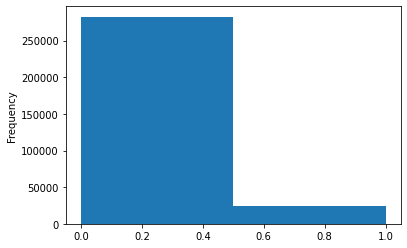

In [ ]:
# Imbalence
train_df.TARGET.value_counts(normalize=True , dropna=False).to_frame().style.background_gradient('cividis')
train_df['TARGET'].astype(int).plot.hist(bins=2)

In [ ]:
train_df.CODE_GENDER.value_counts(normalize=True,dropna=False).to_frame().style.background_gradient('cividis') ;      # code : 1 : F  &  0 : M

# Imputer les données manquantes
- Nous avons utilisé le `SimpleImputer`, car c'est très lent avec KNNImputer et IterativeImputer.
- Nous avons pris `20%` des données dans `train_df` pour test un autre modèle de classification.

In [4]:
# On entraine le modèle d'abord avec 20% des données
sample_train_df = train_df.sample(int(len(train_df) * 0.2))
print("sample_train_df Shape:{}".format(sample_train_df.shape))

sample_train_df Shape:(61501, 798)


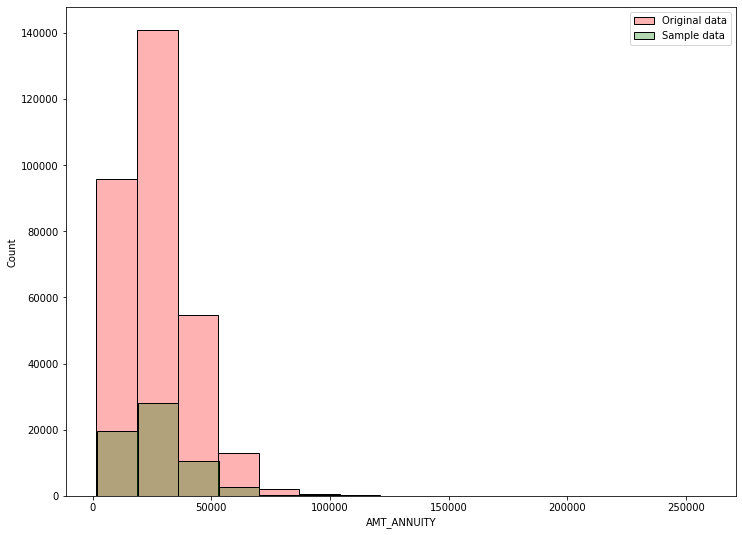

In [ ]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(12, 9))

sns.histplot( data=train_df, x="AMT_ANNUITY", label="Original data", color="red", alpha=0.3, bins=15)
sns.histplot(data=sample_train_df, x="AMT_ANNUITY", label="Sample data", color="green", alpha=0.3, bins=15)

plt.legend()
plt.show();

<AxesSubplot:>

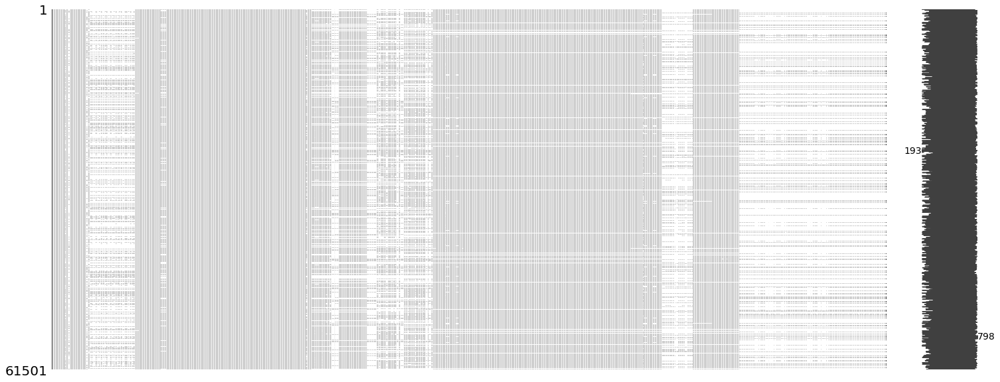

In [ ]:
import missingno as msno
# les valeurs manquantes avec des lignes vides et les valeurs non manquantes avec des lignes noires.
msno.matrix(sample_train_df)

# Modele
- La variable y est une variable catégorielle binaire avec des valeurs 0 et 1 et qu'il y a 92 % de zéros et 8 % de uns,
- La méthode train_test_split avec son option `stratify=y` s'assurera que la répartition aléatoire contient 92 % de 0's et 8 % de 1's.

In [5]:
# Sépartaion des données
feats = [f for f in sample_train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
X = sample_train_df[feats]
y = sample_train_df.TARGET
print("X shape: {}, y shape: {}".format(X.shape, y.shape))

from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, stratify=y, random_state=1121218)

X shape: (61501, 795), y shape: (61501,)


# Sélection du modèle :

In [ ]:
classifiers = [
    DummyClassifier(strategy='stratified'),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    AdaBoostClassifier(),
    CatBoostClassifier()  
    ]
    
for classifier in classifiers:
    pipe = Pipeline(steps=[('imputer', SimpleImputer(strategy='most_frequent', fill_value='missing')),('classifier', classifier)])
    pipe.fit(X_train, y_train)   
    # predict
    preds=pipe.predict_proba(X_valid)
    print(classifier)
    print("model AUC score: %.3f" % roc_auc_score(y_valid, preds[:, 1]))

/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


DummyClassifier(strategy='stratified')
model score: 0.512


/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


DecisionTreeClassifier()
model score: 0.549


/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


RandomForestClassifier()
model score: 0.707


/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


AdaBoostClassifier()
model score: 0.749


/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


Learning rate set to 0.052897
0:	learn: 0.6395987	total: 249ms	remaining: 4m 8s
1:	learn: 0.5914008	total: 364ms	remaining: 3m 1s
2:	learn: 0.5516094	total: 468ms	remaining: 2m 35s
3:	learn: 0.5165409	total: 565ms	remaining: 2m 20s
4:	learn: 0.4850109	total: 657ms	remaining: 2m 10s
5:	learn: 0.4588558	total: 734ms	remaining: 2m 1s
6:	learn: 0.4340893	total: 833ms	remaining: 1m 58s
7:	learn: 0.4129430	total: 927ms	remaining: 1m 55s
8:	learn: 0.3955047	total: 1.02s	remaining: 1m 52s
9:	learn: 0.3804990	total: 1.11s	remaining: 1m 50s
10:	learn: 0.3657444	total: 1.21s	remaining: 1m 48s
11:	learn: 0.3526534	total: 1.31s	remaining: 1m 47s
12:	learn: 0.3417531	total: 1.41s	remaining: 1m 46s
13:	learn: 0.3328665	total: 1.49s	remaining: 1m 45s
14:	learn: 0.3245785	total: 1.59s	remaining: 1m 44s
15:	learn: 0.3179342	total: 1.69s	remaining: 1m 43s
16:	learn: 0.3108083	total: 1.79s	remaining: 1m 43s
17:	learn: 0.3049123	total: 1.88s	remaining: 1m 42s
18:	learn: 0.3002846	total: 1.98s	remaining: 1m

/home/ying/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


model score: 0.771


# Modele : CatBoostClassifier

# HavingGridSearchCV

In [8]:
%%time

from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV

# construction des dictionnaires d’hyperparamètres en donnant une nouvelle intervalle des paramètes
param_grid = {  "loss_function": ['MultiClass'],
                "learning_rate": [0.1,0.2],
                "iterations": [300, 400],
                #"logging_level" :['Verbose']
            }
model_CBC =  CatBoostClassifier()
# Init the estimater
halving_cv = HalvingGridSearchCV(model_CBC, param_grid, scoring="roc_auc", min_resources="exhaust", factor = 4)

# Fit
halving_cv.fit(X_train, y_train)

0:	learn: 0.6270973	total: 435ms	remaining: 2m 10s
1:	learn: 0.5730859	total: 550ms	remaining: 1m 21s
2:	learn: 0.5281138	total: 677ms	remaining: 1m 7s
3:	learn: 0.4905873	total: 825ms	remaining: 1m 1s
4:	learn: 0.4589894	total: 963ms	remaining: 56.8s
5:	learn: 0.4322339	total: 1.08s	remaining: 53s
6:	learn: 0.4093999	total: 1.18s	remaining: 49.6s
7:	learn: 0.3900163	total: 1.28s	remaining: 46.7s
8:	learn: 0.3733635	total: 1.4s	remaining: 45.2s
9:	learn: 0.3591571	total: 1.56s	remaining: 45.3s
10:	learn: 0.3465866	total: 1.73s	remaining: 45.5s
11:	learn: 0.3361130	total: 1.85s	remaining: 44.5s
12:	learn: 0.3261254	total: 1.97s	remaining: 43.4s
13:	learn: 0.3183137	total: 2.1s	remaining: 42.9s
14:	learn: 0.3115401	total: 2.21s	remaining: 42s
15:	learn: 0.3052775	total: 2.31s	remaining: 40.9s
16:	learn: 0.3002152	total: 2.4s	remaining: 40s
17:	learn: 0.2952403	total: 2.5s	remaining: 39.1s
18:	learn: 0.2908370	total: 2.59s	remaining: 38.3s
19:	learn: 0.2867987	total: 2.71s	remaining: 38s


HalvingGridSearchCV(estimator=<catboost.core.CatBoostClassifier object at 0x7fdfdb244610>,
                    factor=4,
                    param_grid={'iterations': [300, 400],
                                'learning_rate': [0.1, 0.2],
                                'loss_function': ['MultiClass']},
                    scoring='roc_auc')

In [9]:
# affichage des AUC pour la combinaison obtenant
print("Full AUC score:", halving_cv.best_score_, '\n')

# les meilleurs résultats
best_params = halving_cv.best_params_

print("Enregistrer les meilleurs paramètres pour CatBoostClassifier...")
best_params

Full AUC score: 0.760917020539532 

Enregistrer les meilleurs paramètres pour CatBoostClassifier...


{'iterations': 300, 'learning_rate': 0.1, 'loss_function': 'MultiClass'}

## Construire les modèles avec les meilleurs paramètres. 
- Puis on entregistre le modèle.
- AUC - RF: 0.7516000165609498
- Meilleurs paramètres RF: {'iterations': 300, 'learning_rate': 0.1, 'loss_function': 'MultiClass'}


In [10]:
#Créons un classificateur final avec les paramètres ci-dessus : 
final_CBC =CatBoostClassifier(**halving_cv.best_params_)

# Fit
final_CBC.fit(X_train, y_train, verbose=False, plot=False)

# Predict => predict_proba : (n_échantillons, n_classes)
preds =final_CBC.predict_proba(X_valid)

# Score
print("CatBoostClassifier AUC : %.4f "% roc_auc_score(y_valid, preds[:, 1]))

CatBoostClassifier AUC : 0.7698 


In [ ]:
from joblib import dump
dump(final_CBC, './final_CatBoostClassifier.joblib')

['./final_CatBoostClassifier.joblib']

## Crosse validation

In [14]:
folds = KFold(n_splits= 10, shuffle=True, random_state=1001)

oof_preds = np.zeros(X.shape[0])

for n_fold, (train_idx, valid_idx) in enumerate(folds.split(X, y)):
        train_x, train_y = X.iloc[train_idx], y.iloc[train_idx]
        valid_x, valid_y = X.iloc[valid_idx], y.iloc[valid_idx]


        clf = final_CBC

        clf.fit(train_x, train_y, early_stopping_rounds= 200)

        oof_preds[valid_idx] = clf.predict_proba(valid_x)[:, 1]

       
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))

0:	learn: 0.6267589	total: 1.09s	remaining: 5m 25s
1:	learn: 0.5725499	total: 1.49s	remaining: 3m 41s
2:	learn: 0.5277603	total: 1.8s	remaining: 2m 58s
3:	learn: 0.4901447	total: 2.12s	remaining: 2m 36s
4:	learn: 0.4581599	total: 2.47s	remaining: 2m 25s
5:	learn: 0.4314119	total: 2.75s	remaining: 2m 14s
6:	learn: 0.4087520	total: 3.06s	remaining: 2m 8s
7:	learn: 0.3890227	total: 3.37s	remaining: 2m 2s
8:	learn: 0.3725565	total: 3.67s	remaining: 1m 58s
9:	learn: 0.3575453	total: 3.96s	remaining: 1m 55s
10:	learn: 0.3445971	total: 4.3s	remaining: 1m 52s
11:	learn: 0.3338061	total: 4.61s	remaining: 1m 50s
12:	learn: 0.3240067	total: 4.91s	remaining: 1m 48s
13:	learn: 0.3156969	total: 5.22s	remaining: 1m 46s
14:	learn: 0.3088798	total: 5.54s	remaining: 1m 45s
15:	learn: 0.3024149	total: 5.92s	remaining: 1m 45s
16:	learn: 0.2967536	total: 6.32s	remaining: 1m 45s
17:	learn: 0.2922243	total: 6.6s	remaining: 1m 43s
18:	learn: 0.2881806	total: 6.92s	remaining: 1m 42s
19:	learn: 0.2844874	total:

In [44]:
print('Full AUC score %.6f' % roc_auc_score(y, oof_preds))

Full AUC score 0.765659


# Fonction de coût de métier
- Déterminer un seuil à partir duquel la proba calculée se transforme en classe 1
    - Choisissez Rappel si l'idée de faux positifs est bien meilleure que les faux négatifs, 
    - en d'autres termes, si l'occurrence de faux négatifs est inacceptable/intolérable , que vous préféreriez obtenir des faux positifs supplémentaires (fausses alarmes) plutôt que d'enregistrer des faux négatifs, 

- 1 ->  positif  -> Fraude
- 0  -> negatif  -> Sans Fraude

- Pas bien : FN à minimiser

- Un ensemble de seuils différents est utilisé pour interpréter le taux de vrais positifs et le taux de faux positifs des prédictions sur la classe positive (minoritaire), et les scores sont tracés sur une ligne de seuils croissants pour créer une courbe.

In [6]:
from joblib import load
model = load('./LightGBMC.joblib')

In [43]:
# Predict => predict_proba : (n_échantillons, n_classes)
preds =model.predict_proba(X_valid)

# Score
print("LightGBMC AUC : %.4f "% roc_auc_score(y_valid, preds[:, 1]))

LightGBMC AUC : 0.9906 


## Méthode 1 : Déterminer le seuil (thresholds) via `roc_curve`

In [20]:
from sklearn.metrics import roc_curve,plot_roc_curve, balanced_accuracy_score

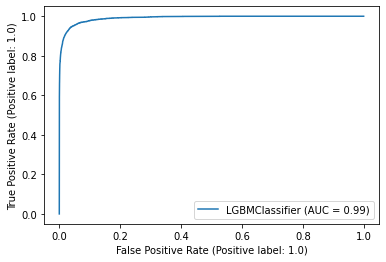

In [21]:
from sklearn.metrics import plot_roc_curve
plot_roc_curve(model,X_train,y_train)

In [22]:
# fpr = précision & tpr =  recall
fpr, tpr, thresholds = roc_curve(y_valid,preds[:,1],drop_intermediate=False, pos_label =1) 
fnr = 1 -tpr

fn = fnr*(sample_train_df.TARGET.value_counts(normalize=True)[1])
fp =fpr*(sample_train_df.TARGET.value_counts(normalize=True)[0])   # 0.92

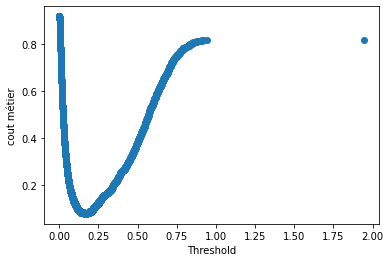

seuil : 0.16851949339383293
cout métier minimum :  0.07609463061743808


In [23]:
plt.scatter(thresholds, (10*fn + fp))
plt.xlabel("Threshold")
plt.ylabel("cout métier")
plt.show()

threshold_min = thresholds[np.argmin(10*fn + fp)]
print("seuil :" , threshold_min)
print("coût métier minimum : ", min(10*fn + fp))
y_pred = [1 if x >= threshold_min else 0 for x in preds[:, 1]]


In [51]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics
# Create the confusion matrix
tn, fp, fn, tp = confusion_matrix(y_valid, y_pred).ravel()
print("TN: {}   FP: {}   FN: {}   TP: {}".format(tn, fp, fn, tp),'\n')

print(metrics.classification_report(y_valid, y_pred, digits=3))

cost_metier = 10*fn + fp
print("coût métier :", cost_metier)

f2 = fbeta_score(y_valid, y_pred, average = 'weighted', beta=2) # option : average='weighted'/ 'micro' / ('macro' : pas de déséquilibre)
print("F2-Mesure: %.4f "% f2)

TN: 13628   FP: 490   FN: 68   TP: 1190 

              precision    recall  f1-score   support

         0.0      0.995     0.965     0.980     14118
         1.0      0.708     0.946     0.810      1258

    accuracy                          0.964     15376
   macro avg      0.852     0.956     0.895     15376
weighted avg      0.972     0.964     0.966     15376

coût métier : 1170
F2-Mesure: 0.9642 


## Méthode 2 : Maximiser l'accuracy

In [26]:
from sklearn.metrics import precision_recall_curve
from sklearn import metrics

precision, recall, thresholds = precision_recall_curve(y_valid, preds[:,1]) 

#retrieve probability of being 1(in second column of probs_y)
pr_auc = metrics.auc(recall, precision)

In [27]:
%%time

threshold = []
accuracy = []

for p in np.unique(preds[:,1]):
  threshold.append(p)
  y_pred = (preds[:,1] >= p).astype(int)
  accuracy.append(balanced_accuracy_score(y_valid,y_pred))

CPU times: user 4min 39s, sys: 109 ms, total: 4min 39s
Wall time: 4min 41s


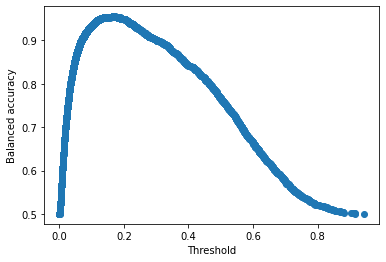

seuil : 0.16851949339383293


In [28]:
plt.scatter(threshold, accuracy)
plt.xlabel("Threshold")
plt.ylabel("Balanced accuracy")
plt.show()

threshold_min = threshold[np.argmax(accuracy)]
print("seuil :" , threshold_min)

y_pred = [1 if x >= threshold_min else 0 for x in preds[:, 1]]

In [52]:
from sklearn.metrics import confusion_matrix
# Create the confusion matrix
tn, fp, fn, tp = confusion_matrix(y_valid, y_pred).ravel()
print("TN: {}   FP: {}   FN: {}   TP: {}".format(tn, fp, fn, tp),'\n')

print(metrics.classification_report(y_valid, y_pred, digits=3))

cost_metier = 10*fn + fp
print("coût métier :", cost_metier)

# F2-Score (beta=2) : Less weight on precision, more weight on recall
f2 = fbeta_score(y_valid, y_pred, average = 'weighted', beta=2) # option : average='weighted'/ 'micro' / ('macro' : pas de déséquilibre)
print("F2-Mesure: %.4f "% f2)

TN: 13628   FP: 490   FN: 68   TP: 1190 

              precision    recall  f1-score   support

         0.0      0.995     0.965     0.980     14118
         1.0      0.708     0.946     0.810      1258

    accuracy                          0.964     15376
   macro avg      0.852     0.956     0.895     15376
weighted avg      0.972     0.964     0.966     15376

coût métier : 1170
F2-Mesure: 0.9642 


In [30]:
threshold_step =threshold_min 

bc.predicted_proba_violin_plot(true_y = y_valid,
                               predicted_proba = preds[:,1], 
                               threshold_step = threshold_step)

# Feautre importance

In [32]:
# final_CBC
fi_df = pd.DataFrame()
fi_df["feature_names"] = feats
fi_df["importance"] = model.feature_importances_
fi_df.sort_values(by="importance" , ascending=False)[:20]

,feature_names,importance
244,PAYMENT_RATE,3768
31,EXT_SOURCE_2,3762
32,EXT_SOURCE_3,3603
30,EXT_SOURCE_1,3162
9,DAYS_BIRTH,3130
10,DAYS_EMPLOYED,2947
240,DAYS_EMPLOYED_PERC,2804
11,DAYS_REGISTRATION,2750
12,DAYS_ID_PUBLISH,2738
243,ANNUITY_INCOME_PERC,2324


In [ ]:
feats = [f for f in test_df.columns if f not in ['TARGET','index','SK_ID_CURR']] #,'SK_ID_BUREAU','SK_ID_PREV']]

model = load("LightGBMC.joblib")



In [33]:
feature_importance = model.feature_importances_
feature_names = np.array(test_df[feats].columns)

In [34]:

import plotly.express as px
def plot_feature_importance():
    #X= test_df.loc[test_df.SK_ID_CURR== id, feats]
    #feat_importances = pd.Series(model.feature_importances_, index = X.columns).sort_values(ascending = True)[:20]
    feature_importance = model.feature_importances_
    feature_names = np.array(test_df[feats].columns)
    
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Plot Searborn bar chart
    fig = px.histogram(fi_df, x=fi_df['feature_importance'], y=fi_df['feature_names'])
    fig.show()

In [ ]:
plot_feature_importance()

# SHAP
- explain the model's predictions using SHAP

In [33]:
# Imputer les valeurs manquantes 
# Imputing with SimpleImputer
from sklearn.impute import SimpleImputer
most_imputer = SimpleImputer(strategy='most_frequent')
sample_train_df =pd.DataFrame(most_imputer.fit_transform(sample_train_df), 
                              columns=sample_train_df.columns)

invalid value encountered in reduce
invalid value encountered in reduce


In [34]:
# Sépartaion des données
feats = [f for f in sample_train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
X = sample_train_df[feats]
y = sample_train_df.TARGET
print("X shape: {}, y shape: {}".format(X.shape, y.shape))

from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, stratify=y, random_state=1121218)

X shape: (61501, 795), y shape: (61501,)


In [35]:
%%time

# Shap values with LightGBM core model
preds = model.predict_proba(X_train)


CPU times: user 3min 23s, sys: 1.59 s, total: 3min 24s
Wall time: 46.1 s


In [36]:
#model = final_CBC
feat_names = list(X_train.columns)

# test
row1 = np.random.randint(X_train.shape[0])
row2 = np.random.randint(X_train.shape[0])
test_1 = X_train.iloc[row1]
test_2 = X_train.iloc[row2]
print(row1, row2)

36690 4459


In [39]:
%%time 
import shap
shap.initjs() 
# explain the model's predictions using SHAP
# Create a tree explainer
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


CPU times: user 1h 57min 6s, sys: 15.3 s, total: 1h 57min 21s
Wall time: 19min 13s


In [40]:
tmp = pd.DataFrame(shap_values[1], columns = X_train.columns)
tmp.head()

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,...,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT
0,0.116950,-0.003510,-0.019622,-0.006057,0.055618,0.178075,0.383207,-0.169421,-0.051805,-0.049576,...,0.0,-0.000022,0.0,0.001254,0.0,0.0,0.0,0.0,0.0,-0.017623
1,0.220455,0.005303,0.005030,0.009619,-0.008118,-0.161331,-0.442552,0.164106,0.079322,-0.096725,...,0.0,-0.000071,0.0,0.000600,0.0,0.0,0.0,0.0,0.0,-0.018792
2,-0.070307,0.001554,0.005709,0.003508,-0.023342,0.168425,0.211794,-0.298534,0.081948,0.046762,...,0.0,-0.000018,0.0,0.000593,0.0,0.0,0.0,0.0,0.0,-0.012610
3,-0.029349,0.003137,0.010622,0.004176,0.001721,-0.118899,-0.235075,0.103177,0.122165,-0.069639,...,0.0,-0.000065,0.0,0.000910,0.0,0.0,0.0,0.0,0.0,-0.018188
4,-0.064354,-0.000467,0.002888,-0.002897,-0.017375,-0.007446,-0.074040,0.151778,-0.172064,-0.191204,...,0.0,-0.000021,0.0,0.000922,0.0,0.0,0.0,0.0,0.0,-0.014989


### Exlications globales

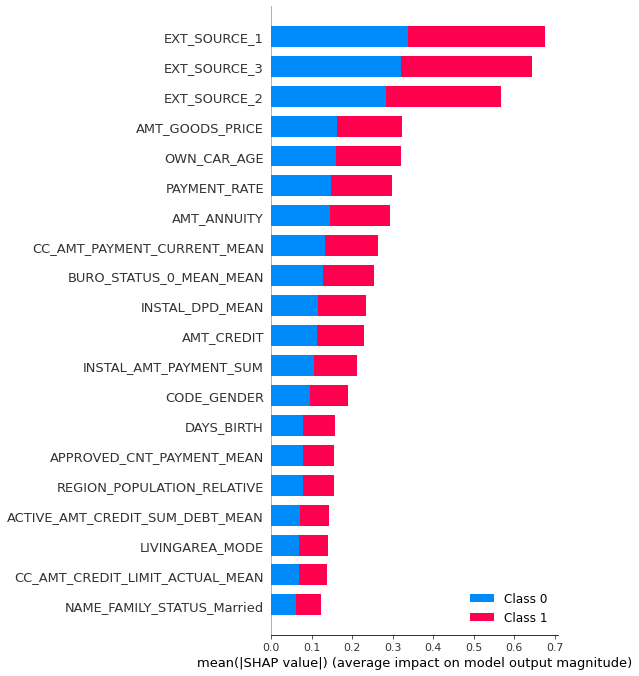

In [41]:
shap.summary_plot(shap_values, features=feat_names)

### Explication la classe 1

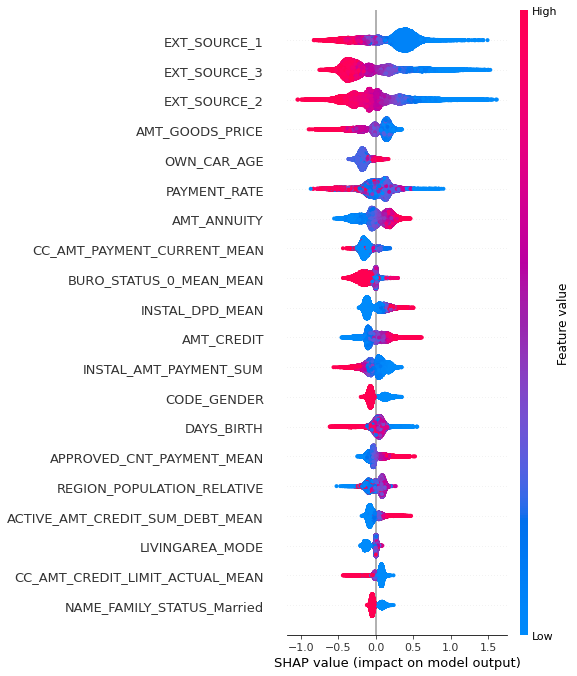

In [42]:
shap.summary_plot(shap_values[1], X_train.values, feature_names = feat_names)

### Explication la classe 0

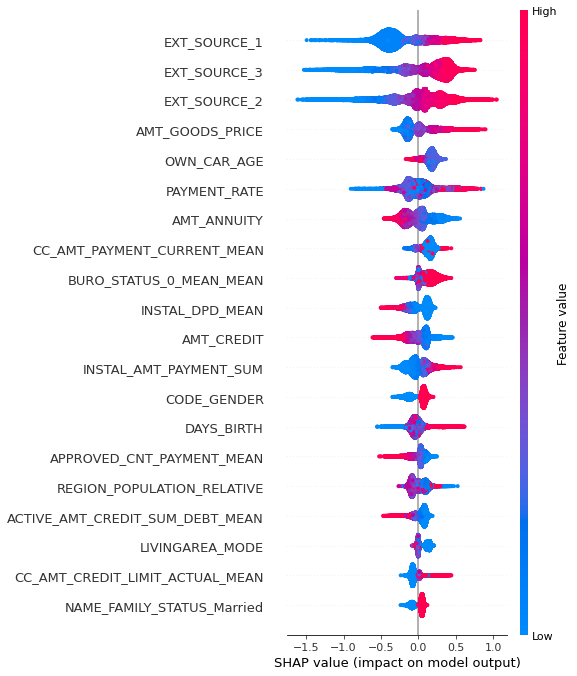

In [43]:
shap.summary_plot(shap_values[0], X_train.values, feature_names = feat_names)
# Contraire à celui en haut

### Explication des premiers 100 individus dans la classe 1

In [44]:
shap.force_plot(explainer.expected_value[1], shap_values[1][:100,:], X_train.iloc[:100,:])

### Explications locals : test 1 : row1

In [45]:
shap.force_plot(explainer.expected_value[1], shap_values[1][row1], test_1, feature_names =feat_names )

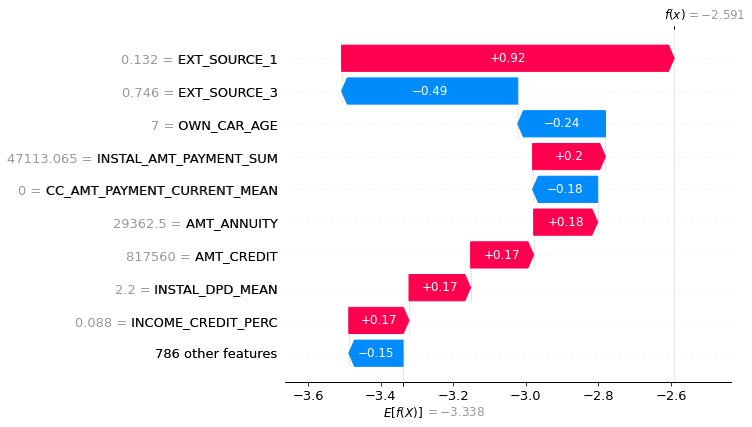

In [46]:
# Le diagramme en cascade
shap.waterfall_plot(shap.Explanation(values=shap_values[1][row1], 
                                            base_values=explainer.expected_value[1], data=test_1,  
                                         feature_names = feat_names))

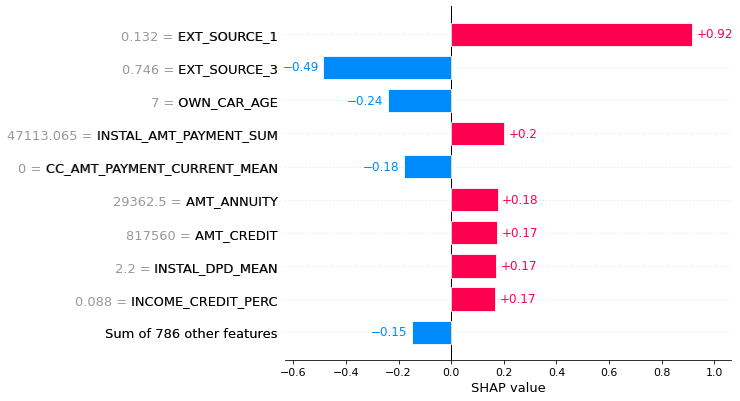

In [47]:
# Le diagramme à barres est centré sur zéro pour montrer les contributions des variables
shap.plots.bar(shap.Explanation(values=shap_values[1][row1], 
                                              base_values=explainer.expected_value[1], data=test_1,  
                                         feature_names = feat_names))

The expected value is  -3.3381365795975833


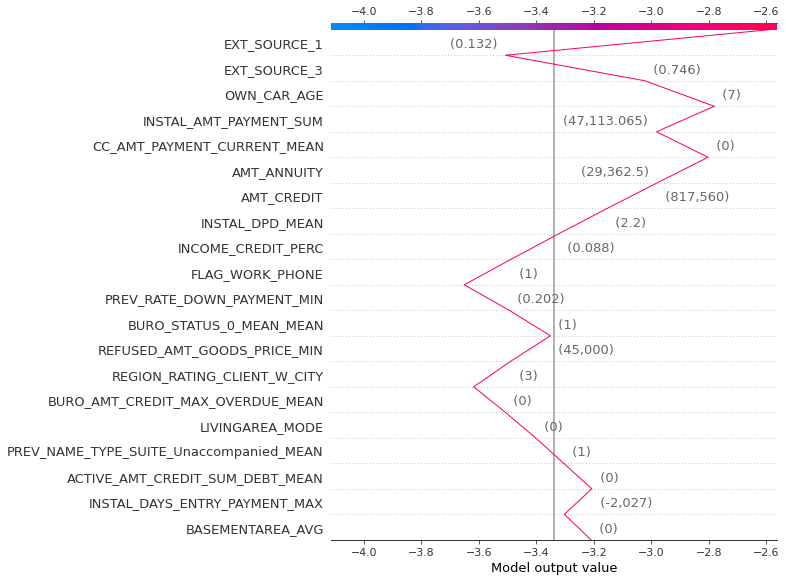

In [48]:
print("The expected value is ", explainer.expected_value[1])
shap.decision_plot( explainer.expected_value[1], shap_values[1][row1], test_1, feature_names=feat_names)

### Explications locals : test : row2

In [49]:
shap.force_plot(explainer.expected_value[1], shap_values[1][row2], test_2, feature_names =feat_names )

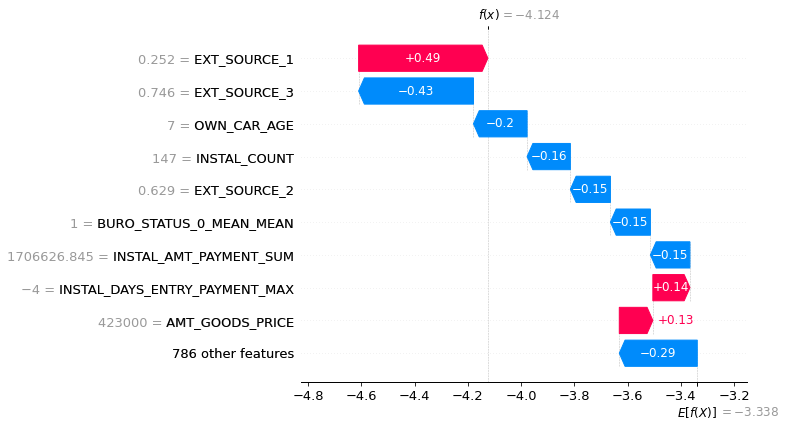

In [50]:
shap.waterfall_plot(shap.Explanation(values=shap_values[1][row2], 
                                              base_values=explainer.expected_value[1], data=test_2,  
                                         feature_names = feat_names))

The expected value is  -3.3381365795975833


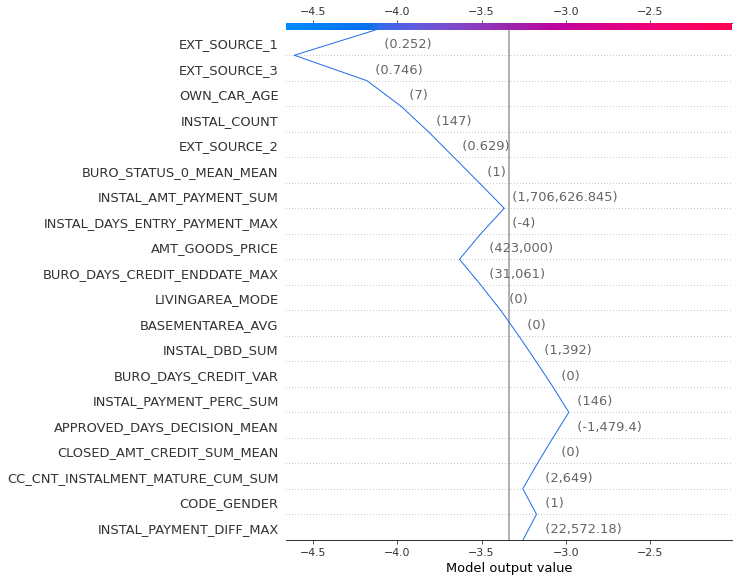

In [51]:
print("The expected value is ", explainer.expected_value[1])
shap.decision_plot( explainer.expected_value[1], shap_values[1][row2], test_2, feature_names=feat_names)

In [52]:
print("Valeur de base pour la classe 0 : {} ".format( explainer.expected_value[0]))
print("Valeur de base pour la classe 1 : {} ".format( explainer.expected_value[1]))

Valeur de base pour la classe 0 : 3.3381365795975833 
Valeur de base pour la classe 1 : -3.3381365795975833 


In [53]:
val0 = explainer.expected_value[0]+ shap_values[0][row1].sum()
val1 = explainer.expected_value[1]+ shap_values[1][row1].sum()

print("Prédiction de l'ajout de valeurs SHAP à la valeur de base : class {}" .format(np.argmax([val0,val1])))

Prédiction de l'ajout de valeurs SHAP à la valeur de base : class 0


In [ ]:
val0 = explainer.expected_value[0]+ shap_values[0][row2].sum()
val1 = explainer.expected_value[1]+ shap_values[1][row2].sum()

print("Prédiction de l'ajout de valeurs SHAP à la valeur de base : class {}" .format(np.argmax([val0,val1])))

Prédiction de l'ajout de valeurs SHAP à la valeur de base : class 0


In [54]:

shap_values_test = explainer.shap_values(test_df[feats])

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
